In [1]:
import numpy as np
import matplotlib.pyplot as plt
import random

[1.31245552e+000 4.68680078e-001 9.55865867e-001 ... 1.67327057e-135
 1.22368582e-135 5.28111248e-136]


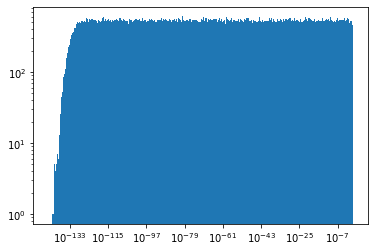

In [9]:
iteration = 500
numSteps = 1000
initMass = 10
masses = np.array([initMass])
fullMass = np.array([])
idx = 0
param = 1

for i in range(iteration):
    for j in range(numSteps):
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
        if random.uniform(0,1) < param:
            if split < 0.5:
                idx = len(masses) - 1
        else:
            if split > 0.5:
                idx = len(masses) - 1
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0

print(fullMass)
logbins = np.logspace(np.log10(min(fullMass)), np.log10(1.0), 1000)

plt.hist(fullMass, bins=logbins)
plt.xscale('log')
plt.yscale('log')
plt.show()





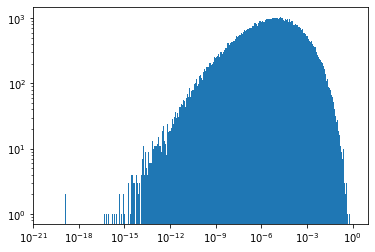

In [28]:
iteration = 500
numSteps = 1000
initMass = 1
masses = np.array([initMass])
fullMass = np.array([])
idx = 0

for i in range(iteration):
    for j in range(numSteps):
        idx = random.randint(0,len(masses)-1)
        split = random.uniform(0,1)
        masses = np.append(masses, masses[idx] * (1-split))
        masses[idx] = masses[idx] * split
    fullMass = np.append(fullMass, masses)
    masses = np.array([initMass])
    idx = 0


logbins = np.logspace(np.log10(10**-20), np.log10(1.0), 2000)
plt.hist(fullMass, bins=logbins)
plt.xscale('log')
plt.yscale('log')
plt.show()



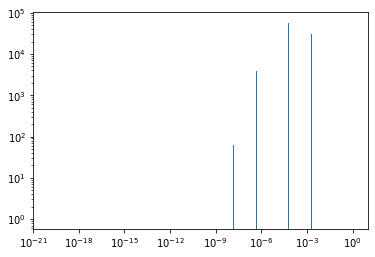

In [7]:
iteration = 500
numSteps = 1000
initMass = 1



[2.9375517062663142e-05, 2.339223224743498e-05, 4.687505739048678e-05, 5.402507243663824e-09, 0.003812577542118546, 7.178815258607518e-06, 5.854007264727859e-05, 1.1196186202719485e-07, 3.5358812073209636e-14, 7.165326797238992e-11, 3.1904166961957003e-10, 5.1191624929653625e-06, 2.53235739311334e-08, 1.0737104263852081e-05, 1.7429172752642704e-08, 4.400444397700357e-09, 9.931279528586533e-08, 1.0645395220190716e-11, 2.613645657222494e-06, 2.2660992693853263e-11, 1.0120761209072429e-05, 6.610867668266478e-07, 2.556006783313568e-06, 5.153082684466273e-08, 3.511952400820038e-07, 1.036048206537058e-08, 5.929554493390982e-06, 3.8222459802728675e-05, 7.62949856817763e-05, 3.085439927893079e-05, 3.454672804182779e-06, 8.263532249485306e-09, 0.00016699045503540302, 4.3237455644387204e-05, 4.121263491211199e-09, 1.440410215122454e-08, 8.346260846851883e-06, 3.1049696012179007e-07, 1.6241247596173645e-09, 2.7113924418858857e-12, 3.4582950758629734e-07, 8.914375722088132e-06, 1.056503519570709e-

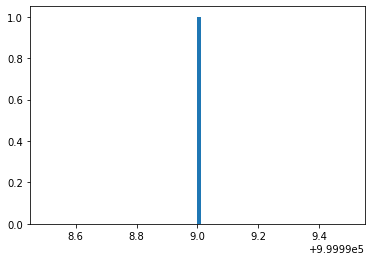

In [6]:
# setup space
sim_size = 10**6
sim_space = [0]*sim_size
sim_count = 0
sim_space[sim_count] = 1
# print(sim_space) # check

# fraction space for one out of simcount+1 elements
while sim_count < sim_size-1:
    rnd_position = random.randint(0,sim_count)
    rnd_fraction = random.random()
    sim_space[sim_count+1]  = sim_space[rnd_position]*(1-rnd_fraction)
    sim_space[rnd_position] = sim_space[rnd_position]*rnd_fraction
    sim_count+=1
    # print(sim_space) # check

print(sim_space) # check
plt.hist(sim_count, bins=100)
# print(sum(sim_space)) # check

plot_size = int(np.log10(sim_size*1000)) # factor adds OOM to the plots
plot_x = [0]*plot_size
plot_y = [0]*plot_size
plot_count = 0

# cumulative counting of space elements
while plot_count < plot_size:
    plot_power = 1/(10**(plot_count+1))
    plot_x[plot_count] = plot_power
    plot_y[plot_count] = len([i for i in sim_space if i > plot_power]) # https://www.geeksforgeeks.org/python-number-of-values-greater-than-k-in-list/
    plot_count+=1

print(plot_x) # check
print(plot_y) # check

# plotting log-log


# output for one run:
# [0.1, 0.01, 0.001, 0.0001, 1e-05, 1e-06, 1e-07, 1e-08, 1e-09]
# [1, 13, 129, 831, 4154, 15869, 44950, 101325, 190545]